In [1]:
%matplotlib widget
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.lines as mlines
import seaborn as sns
import scipy.sparse as sp
import os
from datetime import datetime, timedelta
from torch_geometric.utils import from_scipy_sparse_matrix
from matplotlib.lines import Line2D
from matplotlib.ticker import FormatStrFormatter

In [2]:
step_minutes = 5

history_len = 12 # THIS DOES NOT CHANGE
future_len = 3 # THIS CHANGES!!!!!!!!!
window_len = history_len + future_len

In [3]:
pems7d_data_per_step_short = 70
pems7d_data_per_step_long = 140

pems7d_initial_train_len = 4537
pems7d_train_len = 10137
pems7d_valid_len = 2534
pems7d_total_len = pems7d_train_len + pems7d_valid_len

pems7d_start_datetime = datetime.strptime("01.05.2012 00:00", "%d.%m.%Y %H:%M") # pems7d - 01.05.2012. - 30.06.2012.

In [4]:
pemsbay_data_per_step_short = 70
pemsbay_data_per_step_long = 140

pemsbay_initial_train_len = 29692
pemsbay_train_len = 41692
pemsbay_valid_len = 10423
pemsbay_total_len = pemsbay_train_len + pemsbay_valid_len

pemsbay_start_datetime = datetime.strptime("01.01.2017 00:00", "%d.%m.%Y %H:%M") # pemsbay - 01.01.2017. - 30.06.2017.

In [5]:
def epoch_to_datetime_pems7d(epoch, data_per_step):
    """Convert epoch index (1-based) into datetime"""
    # initial training data is skipped
    base_minutes = pems7d_initial_train_len * step_minutes
    # each epoch after adds data_per_step * step_minutes
    minutes_after = epoch * data_per_step * step_minutes
    return pems7d_start_datetime + timedelta(minutes=base_minutes + minutes_after)

def epoch_to_datetime_pemsbay(epoch, data_per_step):
    """Convert epoch index (1-based) into datetime"""
    # initial training data is skipped
    base_minutes = pems7d_initial_train_len * step_minutes
    # each epoch after adds data_per_step * step_minutes
    minutes_after = epoch * data_per_step * step_minutes
    return pemsbay_start_datetime + timedelta(minutes=base_minutes + minutes_after)

In [6]:
def plot_sf_fl_wmape_scsr_by_dataset(
    base_logs="../../logs",
    cloudlets_human=[3,4,5,7],
    dps=140,
    folders={
        "Server-Free FL - PeMS-BAY - 15min": "2025-09-12_09-32-23_pems-bay_pred-15min_dps-140_server-free-fl-distance_online-training_with_algorithm",
        "Server-Free FL - PeMS-BAY - 60min": "2025-09-12_13-32-51_pems-bay_pred-60min_dps-140_server-free-fl-distance_online-training_with_algorithm",
        "Server-Free FL - PeMSD7-M - 15min": "2025-09-12_23-28-09_pemsd7-m_pred-15min_dps-140_server-free-fl-distance_online-training_with_algorithm",
        "Server-Free FL - PeMSD7-M - 60min": "2025-09-13_00-39-09_pemsd7-m_pred-60min_dps-140_server-free-fl-distance_online-training_with_algorithm",
    },
    marker_size=3,          # a tad bigger than your usual 2
    line_width=1.0,         # a bit thinner
    avg_line_width=1.6,
    verbose_missing=True,
    training_setup = "Server-Free FL",
    timewindow = 140,
):
    import os
    import pandas as pd
    import matplotlib.pyplot as plt
    from matplotlib.ticker import FormatStrFormatter
    from matplotlib.lines import Line2D

    # ---- helpers -----------------------------------------------------------
    def _avg_hline(ax, x_seq, y_seq, color, lw):
        if not len(y_seq):
            return
        import pandas as pd
        y_mean = float(pd.Series(y_seq).mean())
        # span entire subplot width (left edge to right edge), regardless of data margins
        ax.axhline(
            y_mean, xmin=0.0, xmax=1.0,
            color=color, linestyle=(0, (6, 4)),  # dashed; tweak pattern if you like
            linewidth=lw, zorder=6, clip_on=False
        )
        
    def _epoch_to_dt(dataset_key, e, dps):
        e = int(e); dps = int(dps)
        try:
            if "BAY" in dataset_key.upper():
                return epoch_to_datetime_pemsbay(e, dps)
            else:
                return epoch_to_datetime_pems7d(e, dps)
        except NameError:
            return e  # fallback to epoch index

    def _load_val_metric(folder, cln0):
        p = os.path.join(folder, f"val_metric/masked_{cln0}.csv")
        return pd.read_csv(p) if os.path.exists(p) else None

    def _load_new_val_metric(folder, cln0):
        p = os.path.join(folder, f"new_val_metric/masked_{cln0}.csv")
        return pd.read_csv(p) if os.path.exists(p) else None

    def _pick_col(df, candidates):
        for c in candidates:
            if c in df.columns: return c
        lower = {c.lower(): c for c in df.columns}
        for cand in candidates:
            lc = cand.lower()
            for k, v in lower.items():
                if lc in k: return v
        return None

    # columns we may encounter
    WMAPE_COLS = ["WMAPE [%]", "WMAPE", "WMAPE(%)", "WMAPE (%)"]
    SCSR_COLS  = ["Total sudden change in speed rate", "Total sudden change in speed rate [%]",
                  "SCSR", "SCSR [%]"]
    SCSR_COUNT_COL = "Total sudden change in speed count"

    # consistent color & marker per cloudlet
    cloudlets_zero = [c-1 for c in cloudlets_human]
    color_cycle = plt.rcParams['axes.prop_cycle'].by_key()['color']
    COLORS  = {clh: color_cycle[i % len(color_cycle)] for i, clh in enumerate(cloudlets_human)}
    # MARKERS = {
    #     cloudlets_human[0]: 'o',  # circle
    #     cloudlets_human[1]: '^',  # triangle
    #     cloudlets_human[2]: 's',  # square
    #     cloudlets_human[3]: 'D',  # diamond
    # }
    MARKERS_LIST = ['o','^','s','D','v','<','>','p','h','H','d','8']
    MARKERS = {cl: mk for cl, mk in zip(cloudlets_human, MARKERS_LIST)}

    # map figure cells
    cells = [
        (0, 0, "PeMS-BAY",  "15min", f"{training_setup} - PeMS-BAY - 15min"),
        (0, 1, "PeMS-BAY",  "60min", f"{training_setup} - PeMS-BAY - 60min"),
        (1, 0, "PeMSD7-M",  "15min", f"{training_setup} - PeMSD7-M - 15min"),
        (1, 1, "PeMSD7-M",  "60min", f"{training_setup} - PeMSD7-M - 60min"),
    ]
    # cells = [
    #     (0, 0, "PeMS-BAY",  "15min", "Traditional FL - PeMS-BAY - 15min"),
    #     (0, 1, "PeMS-BAY",  "60min", "Traditional FL - PeMS-BAY - 60min"),
    #     (1, 0, "PeMSD7-M",  "15min", "Traditional FL - PeMSD7-M - 15min"),
    #     (1, 1, "PeMSD7-M",  "60min", "Traditional FL - PeMSD7-M - 60min"),
    # ]
    # cells = [
    #     (0, 0, "PeMS-BAY",  "15min", "Gossip Learning - PeMS-BAY - 15min"),
    #     (0, 1, "PeMS-BAY",  "60min", "Gossip Learning - PeMS-BAY - 60min"),
    #     (1, 0, "PeMSD7-M",  "15min", "Gossip Learning - PeMSD7-M - 15min"),
    #     (1, 1, "PeMSD7-M",  "60min", "Gossip Learning - PeMSD7-M - 60min"),
    # ]

    # ---- figure layout -----------------------------------------------------
    fig = plt.figure(figsize=(18, 18), constrained_layout=False)
    outer = fig.add_gridspec(nrows=2, ncols=2, wspace=0.10, hspace=0.22)

    for (r, c, ds_label, horizon, key) in cells:
        folder = os.path.join(base_logs, folders[key])
        trip = outer[r, c].subgridspec(2, 1, hspace=0.0)
        ax_wmape = fig.add_subplot(trip[0, 0])
        ax_scsr  = fig.add_subplot(trip[1, 0], sharex=ax_wmape)  # share within the cell only

        ax_wmape.set_title(f"{ds_label} — {horizon}", fontsize=11)

        for clh, cl0 in zip(cloudlets_human, cloudlets_zero):
            # --- WMAPE (val_metric)
            df_w = _load_val_metric(folder, cl0)
            if df_w is not None:
                col = _pick_col(df_w, WMAPE_COLS)
                if col is not None:
                    e = df_w["Epoch"].to_numpy()
                    y = df_w[col].astype(float).to_numpy()
                    if y.max() <= 1.0001: y = y * 100.0  # show as %
                    x = [_epoch_to_dt(ds_label, ee, dps) for ee in e]

                    ax_wmape.plot(
                        x, y, linestyle="-", linewidth=line_width,
                        marker=MARKERS[clh], markersize=marker_size,
                        color=COLORS[clh], label=f"Cloudlet {clh}"
                    )
                    # dashed average for this cloudlet (WMAPE)
                    _avg_hline(ax_wmape, x, y, COLORS[clh], avg_line_width)
            elif verbose_missing:
                print(f"[wmape] Missing {key} cl{cl0}")

            # --- SCSR (new_val_metric) with event-count filtering
            df_s = _load_new_val_metric(folder, cl0)
            if df_s is not None:
                if SCSR_COUNT_COL in df_s.columns:
                    df_s = df_s[df_s[SCSR_COUNT_COL] > 0].copy()
                if not df_s.empty:
                    col = _pick_col(df_s, SCSR_COLS)
                    if col is not None:
                        e = df_s["Epoch"].to_numpy()
                        y = df_s[col].astype(float).to_numpy()
                        if y.max() <= 1.0001: y = y * 100.0  # show as %
                        x = [_epoch_to_dt(ds_label, ee, dps) for ee in e]

                        ax_scsr.plot(
                            x, y, linestyle="-", linewidth=line_width,
                            marker=MARKERS[clh], markersize=marker_size,
                            color=COLORS[clh], label=f"Cloudlet {clh}"
                        )
                        # dashed average for this cloudlet (SCSR), using filtered epochs
                        _avg_hline(ax_scsr, x, y, COLORS[clh], avg_line_width)
            elif verbose_missing:
                print(f"[scsr] Missing {key} cl{cl0}")

        # styling per cell
        ax_wmape.grid(True, alpha=0.3); ax_scsr.grid(True, alpha=0.3)
        ax_wmape.yaxis.set_major_formatter(FormatStrFormatter('%.2f'))
        ax_scsr.yaxis.set_major_formatter(FormatStrFormatter('%.2f'))
        ax_wmape.set_ylabel("WMAPE [%]")
        ax_scsr.set_ylabel("SEPA [%]")
        ax_scsr.set_ylim(0, 100)

        # show x-axis ONLY on the bottom panel **of every cell**
        ax_wmape.get_xaxis().set_visible(False)
        for tick in ax_scsr.get_xticklabels():
            tick.set_rotation(30); tick.set_ha("right")

    # legend (one for cloudlets)
    leg_handles = [Line2D([0],[0], color=COLORS[cl], marker=MARKERS[cl],
                          linestyle='-', linewidth=line_width, markersize=marker_size,
                          label=f"Cloudlet {cl}") for cl in cloudlets_human]
    leg = fig.legend(leg_handles, [f"Cloudlet {cl}" for cl in cloudlets_human],
                     loc="lower center", bbox_to_anchor=(0.5, 0.02),  # a bit lower
                     ncol=len(cloudlets_human), frameon=True, framealpha=1.0)
    leg.get_frame().set_edgecolor("0.35"); leg.get_frame().set_linewidth(1.0)

    fig.suptitle(f"{training_setup} — WMAPE & SEPA across datasets and horizons (window timestep: {timewindow})", y=0.985, fontsize=14)
    # fig.suptitle("Traditional FL — WMAPE & SCSR across datasets and horizons", y=0.985, fontsize=14)
    # fig.suptitle("Gossip Learning — WMAPE & SCSR across datasets and horizons", y=0.985, fontsize=14)
    # Reserve more bottom space so the legend is not clipped
    fig.subplots_adjust(top=0.93, bottom=0.10, left=0.07, right=0.98, wspace=0.10, hspace=0.22)
    fig.align_ylabels()
    plt.show()


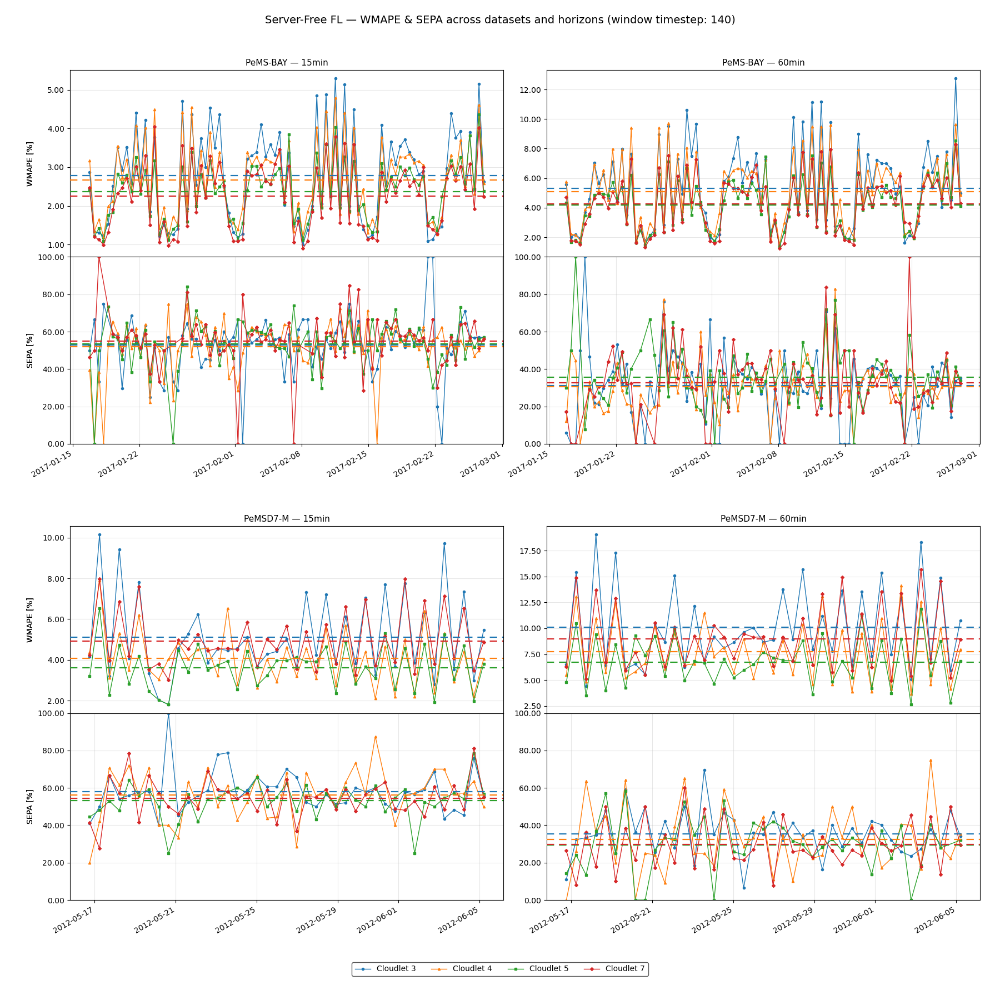

In [7]:
plot_sf_fl_wmape_scsr_by_dataset()

[wmape] Missing Traditional FL - PeMS-BAY - 15min cl7
[scsr] Missing Traditional FL - PeMS-BAY - 15min cl7
[wmape] Missing Traditional FL - PeMS-BAY - 15min cl8
[scsr] Missing Traditional FL - PeMS-BAY - 15min cl8
[wmape] Missing Traditional FL - PeMS-BAY - 15min cl9
[scsr] Missing Traditional FL - PeMS-BAY - 15min cl9
[wmape] Missing Traditional FL - PeMS-BAY - 15min cl10
[scsr] Missing Traditional FL - PeMS-BAY - 15min cl10
[wmape] Missing Traditional FL - PeMS-BAY - 15min cl11
[scsr] Missing Traditional FL - PeMS-BAY - 15min cl11
[wmape] Missing Traditional FL - PeMS-BAY - 60min cl7
[scsr] Missing Traditional FL - PeMS-BAY - 60min cl7
[wmape] Missing Traditional FL - PeMS-BAY - 60min cl8
[scsr] Missing Traditional FL - PeMS-BAY - 60min cl8
[wmape] Missing Traditional FL - PeMS-BAY - 60min cl9
[scsr] Missing Traditional FL - PeMS-BAY - 60min cl9
[wmape] Missing Traditional FL - PeMS-BAY - 60min cl10
[scsr] Missing Traditional FL - PeMS-BAY - 60min cl10
[wmape] Missing Traditional FL 

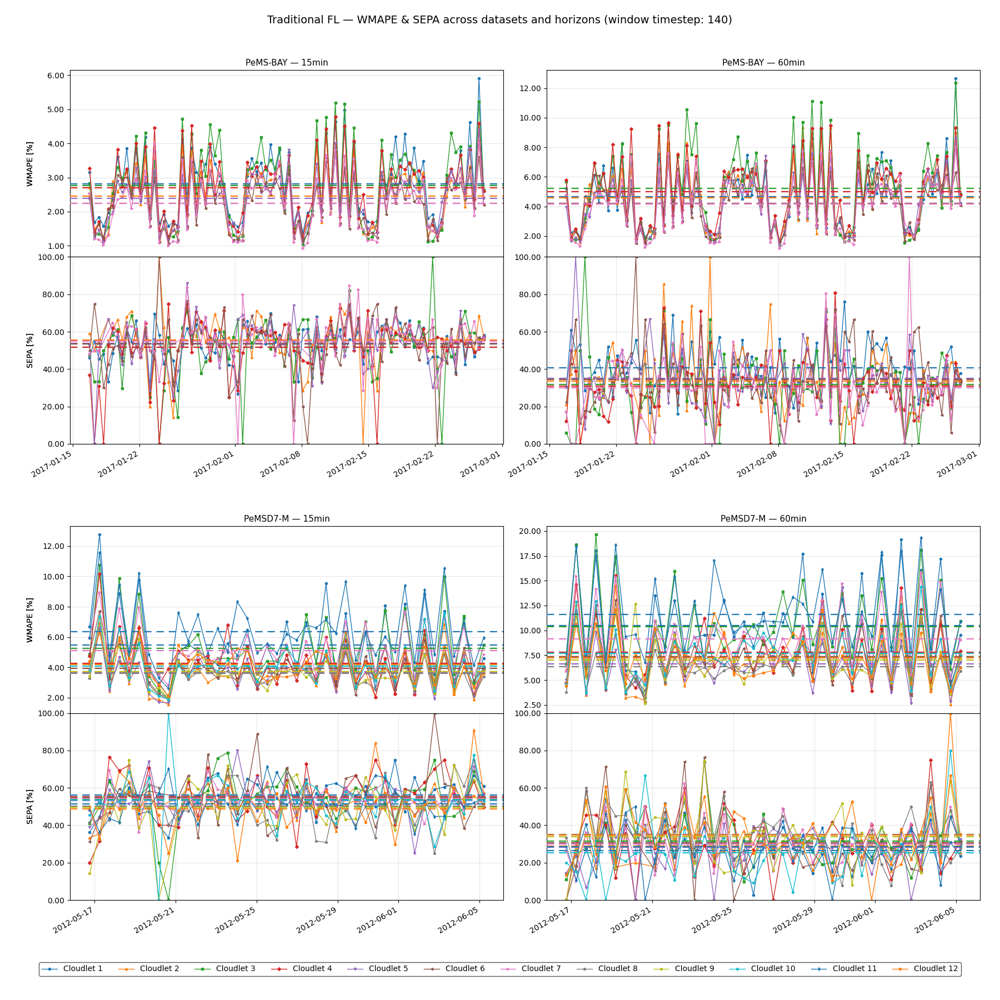

In [8]:
plot_sf_fl_wmape_scsr_by_dataset(
    folders={
        "Traditional FL - PeMS-BAY - 15min": "2025-09-10_09-49-06_pems-bay_pred-15min_dps-140_trad-fl-distance_online-training_with_algorithm",
        "Traditional FL - PeMS-BAY - 60min": "2025-09-10_13-00-40_pems-bay_pred-60min_dps-140_trad-fl-distance_online-training_with_algorithm",
        "Traditional FL - PeMSD7-M - 15min": "2025-09-10_20-02-01_pemsd7-m_pred-15min_dps-140_trad-fl-distance_online-training_with_algorithm",
        "Traditional FL - PeMSD7-M - 60min": "2025-09-10_21-15-40_pemsd7-m_pred-60min_dps-140_trad-fl-distance_online-training_with_algorithm",
    },
    training_setup="Traditional FL",
    cloudlets_human=[1,2,3,4,5,6,7,8,9,10,11,12]
)

[wmape] Missing Gossip Learning - PeMS-BAY - 15min cl7
[scsr] Missing Gossip Learning - PeMS-BAY - 15min cl7
[wmape] Missing Gossip Learning - PeMS-BAY - 15min cl8
[scsr] Missing Gossip Learning - PeMS-BAY - 15min cl8
[wmape] Missing Gossip Learning - PeMS-BAY - 15min cl9
[scsr] Missing Gossip Learning - PeMS-BAY - 15min cl9
[wmape] Missing Gossip Learning - PeMS-BAY - 15min cl10
[scsr] Missing Gossip Learning - PeMS-BAY - 15min cl10
[wmape] Missing Gossip Learning - PeMS-BAY - 15min cl11
[scsr] Missing Gossip Learning - PeMS-BAY - 15min cl11
[wmape] Missing Gossip Learning - PeMS-BAY - 60min cl7
[scsr] Missing Gossip Learning - PeMS-BAY - 60min cl7
[wmape] Missing Gossip Learning - PeMS-BAY - 60min cl8
[scsr] Missing Gossip Learning - PeMS-BAY - 60min cl8
[wmape] Missing Gossip Learning - PeMS-BAY - 60min cl9
[scsr] Missing Gossip Learning - PeMS-BAY - 60min cl9
[wmape] Missing Gossip Learning - PeMS-BAY - 60min cl10
[scsr] Missing Gossip Learning - PeMS-BAY - 60min cl10
[wmape] Missi

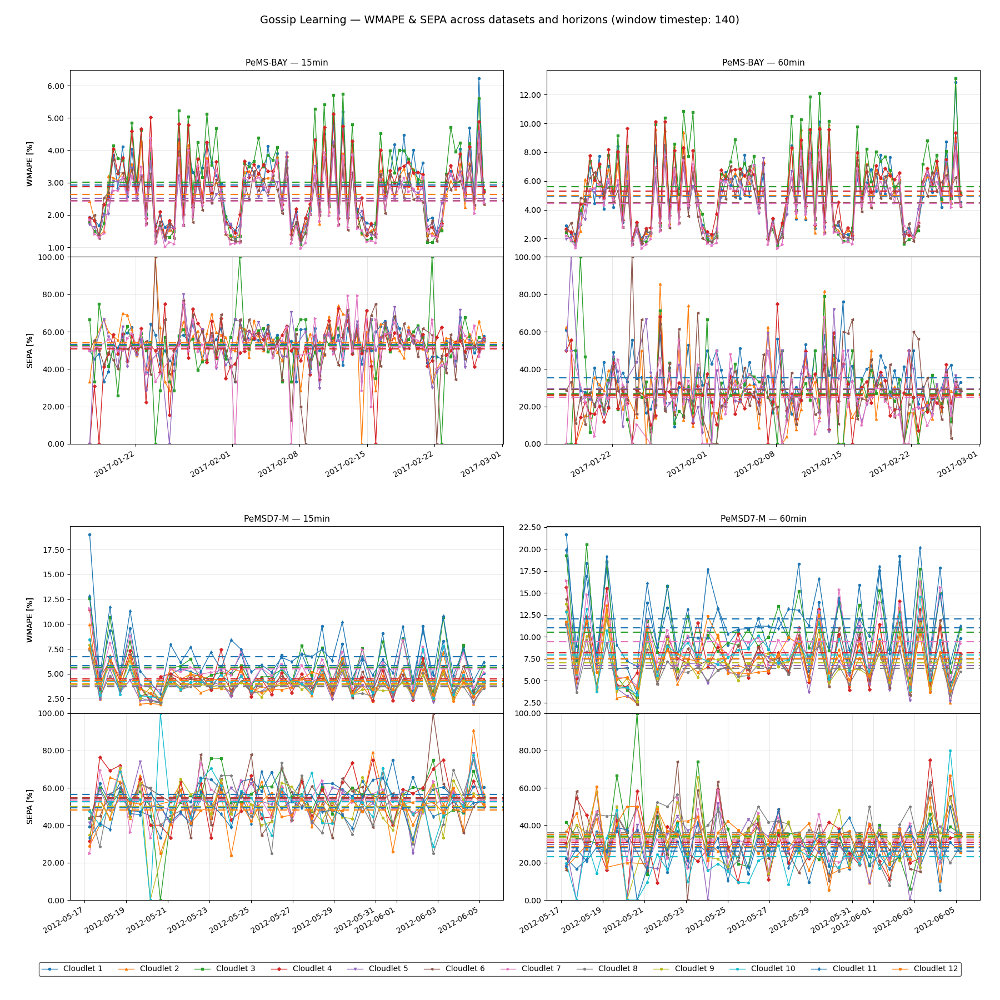

In [9]:
plot_sf_fl_wmape_scsr_by_dataset(
    folders={
        "Gossip Learning - PeMS-BAY - 15min": "2025-09-18_12-03-51_pems-bay_pred-15min_dps-140_gossip-learning-distance_online-training_with_algorithm",
        "Gossip Learning - PeMS-BAY - 60min": "2025-09-18_15-45-43_pems-bay_pred-60min_dps-140_gossip-learning-distance_online-training_with_algorithm",
        "Gossip Learning - PeMSD7-M - 15min": "2025-09-19_01-18-27_pemsd7-m_pred-15min_dps-140_gossip-learning-distance_online-training_with_algorithm",
        "Gossip Learning - PeMSD7-M - 60min": "2025-09-19_02-27-38_pemsd7-m_pred-60min_dps-140_gossip-learning-distance_online-training_with_algorithm",
    },
    training_setup="Gossip Learning",
    cloudlets_human=[1,2,3,4,5,6,7,8,9,10,11,12]
)

[wmape] Missing Server-Free FL - PeMS-BAY - 15min cl7
[scsr] Missing Server-Free FL - PeMS-BAY - 15min cl7
[wmape] Missing Server-Free FL - PeMS-BAY - 15min cl8
[scsr] Missing Server-Free FL - PeMS-BAY - 15min cl8
[wmape] Missing Server-Free FL - PeMS-BAY - 15min cl9
[scsr] Missing Server-Free FL - PeMS-BAY - 15min cl9
[wmape] Missing Server-Free FL - PeMS-BAY - 15min cl10
[scsr] Missing Server-Free FL - PeMS-BAY - 15min cl10
[wmape] Missing Server-Free FL - PeMS-BAY - 15min cl11
[scsr] Missing Server-Free FL - PeMS-BAY - 15min cl11
[wmape] Missing Server-Free FL - PeMS-BAY - 60min cl7
[scsr] Missing Server-Free FL - PeMS-BAY - 60min cl7
[wmape] Missing Server-Free FL - PeMS-BAY - 60min cl8
[scsr] Missing Server-Free FL - PeMS-BAY - 60min cl8
[wmape] Missing Server-Free FL - PeMS-BAY - 60min cl9
[scsr] Missing Server-Free FL - PeMS-BAY - 60min cl9
[wmape] Missing Server-Free FL - PeMS-BAY - 60min cl10
[scsr] Missing Server-Free FL - PeMS-BAY - 60min cl10
[wmape] Missing Server-Free FL 

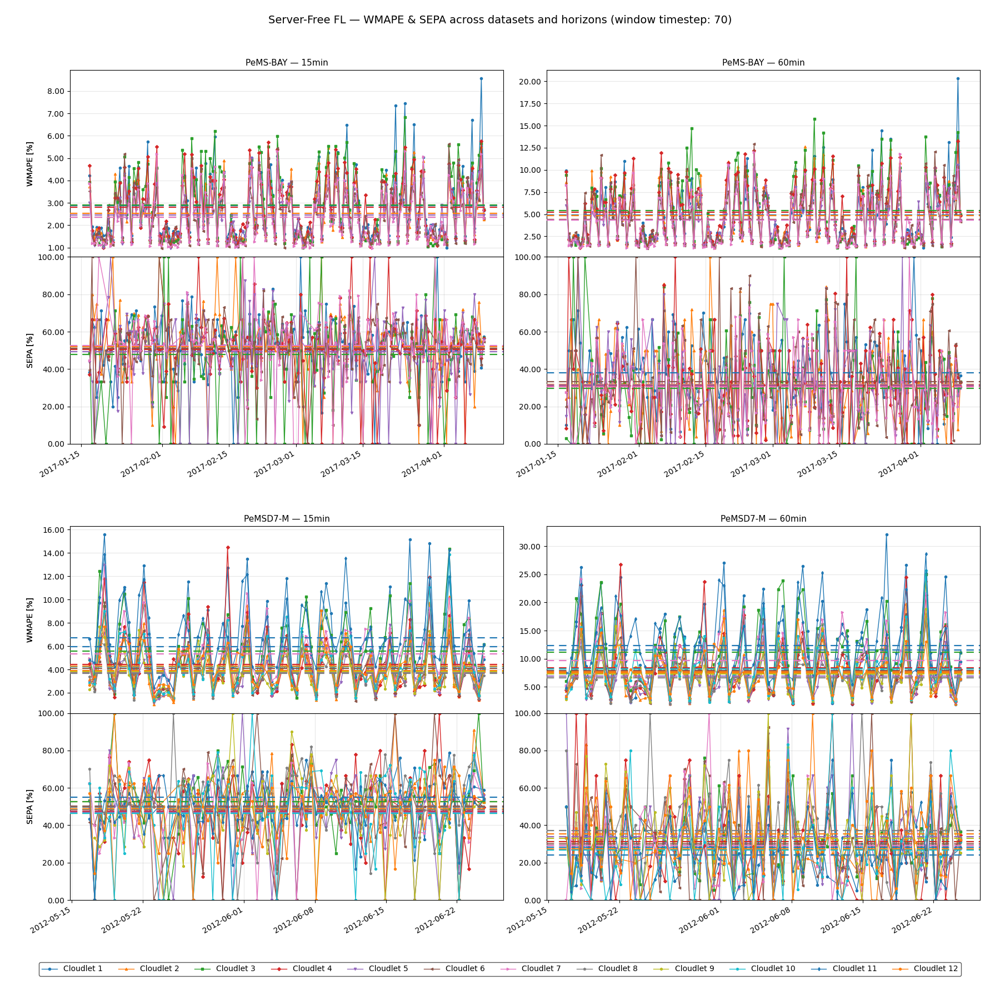

In [10]:
plot_sf_fl_wmape_scsr_by_dataset(
    folders={
        "Server-Free FL - PeMS-BAY - 15min": "2025-09-12_15-41-00_pems-bay_pred-15min_dps-70_server-free-fl-distance_online-training_with_algorithm",
        "Server-Free FL - PeMS-BAY - 60min": "2025-09-12_20-42-41_pems-bay_pred-60min_dps-70_server-free-fl-distance_online-training_with_algorithm",
        "Server-Free FL - PeMSD7-M - 15min": "2025-09-13_01-14-49_pemsd7-m_pred-15min_dps-70_server-free-fl-distance_online-training_with_algorithm",
        "Server-Free FL - PeMSD7-M - 60min": "2025-09-13_02-33-58_pemsd7-m_pred-60min_dps-70_server-free-fl-distance_online-training_with_algorithm",
    },
    training_setup="Server-Free FL",
    cloudlets_human=[1,2,3,4,5,6,7,8,9,10,11,12],
    timewindow=70,
)

[wmape] Missing Traditional FL - PeMS-BAY - 15min cl7
[scsr] Missing Traditional FL - PeMS-BAY - 15min cl7
[wmape] Missing Traditional FL - PeMS-BAY - 15min cl8
[scsr] Missing Traditional FL - PeMS-BAY - 15min cl8
[wmape] Missing Traditional FL - PeMS-BAY - 15min cl9
[scsr] Missing Traditional FL - PeMS-BAY - 15min cl9
[wmape] Missing Traditional FL - PeMS-BAY - 15min cl10
[scsr] Missing Traditional FL - PeMS-BAY - 15min cl10
[wmape] Missing Traditional FL - PeMS-BAY - 15min cl11
[scsr] Missing Traditional FL - PeMS-BAY - 15min cl11
[wmape] Missing Traditional FL - PeMS-BAY - 60min cl7
[scsr] Missing Traditional FL - PeMS-BAY - 60min cl7
[wmape] Missing Traditional FL - PeMS-BAY - 60min cl8
[scsr] Missing Traditional FL - PeMS-BAY - 60min cl8
[wmape] Missing Traditional FL - PeMS-BAY - 60min cl9
[scsr] Missing Traditional FL - PeMS-BAY - 60min cl9
[wmape] Missing Traditional FL - PeMS-BAY - 60min cl10
[scsr] Missing Traditional FL - PeMS-BAY - 60min cl10
[wmape] Missing Traditional FL 

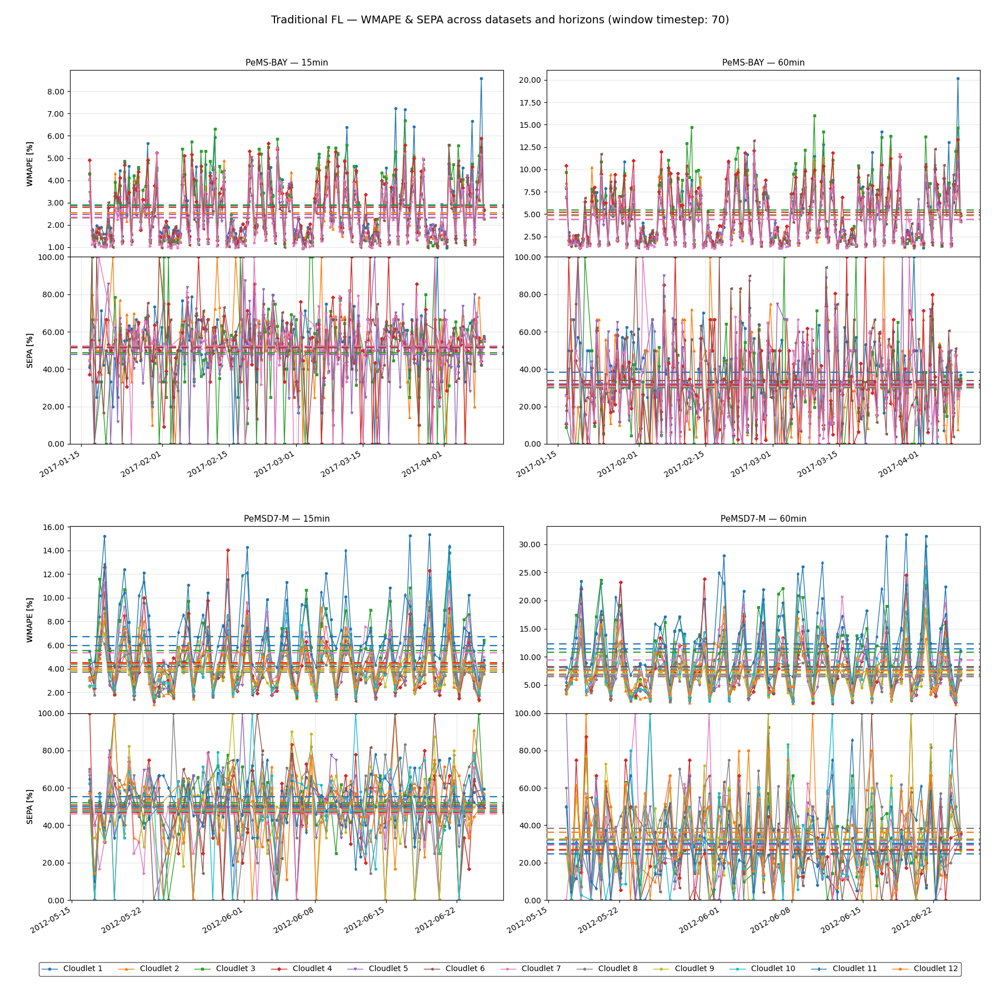

In [11]:
plot_sf_fl_wmape_scsr_by_dataset(
    folders={
        "Traditional FL - PeMS-BAY - 15min": "2025-09-10_14-42-09_pems-bay_pred-15min_dps-70_trad-fl-distance_online-training_with_algorithm",
        "Traditional FL - PeMS-BAY - 60min": "2025-09-10_18-11-19_pems-bay_pred-60min_dps-70_trad-fl-distance_online-training_with_algorithm",
        "Traditional FL - PeMSD7-M - 15min": "2025-09-10_21-53-05_pemsd7-m_pred-15min_dps-70_trad-fl-distance_online-training_with_algorithm",
        "Traditional FL - PeMSD7-M - 60min": "2025-09-10_23-09-27_pemsd7-m_pred-60min_dps-70_trad-fl-distance_online-training_with_algorithm",
    },
    training_setup="Traditional FL",
    cloudlets_human=[1,2,3,4,5,6,7,8,9,10,11,12],
    timewindow=70,
)

[wmape] Missing Gossip Learning - PeMS-BAY - 15min cl7
[scsr] Missing Gossip Learning - PeMS-BAY - 15min cl7
[wmape] Missing Gossip Learning - PeMS-BAY - 15min cl8
[scsr] Missing Gossip Learning - PeMS-BAY - 15min cl8
[wmape] Missing Gossip Learning - PeMS-BAY - 15min cl9
[scsr] Missing Gossip Learning - PeMS-BAY - 15min cl9
[wmape] Missing Gossip Learning - PeMS-BAY - 15min cl10
[scsr] Missing Gossip Learning - PeMS-BAY - 15min cl10
[wmape] Missing Gossip Learning - PeMS-BAY - 15min cl11
[scsr] Missing Gossip Learning - PeMS-BAY - 15min cl11
[wmape] Missing Gossip Learning - PeMS-BAY - 60min cl7
[scsr] Missing Gossip Learning - PeMS-BAY - 60min cl7
[wmape] Missing Gossip Learning - PeMS-BAY - 60min cl8
[scsr] Missing Gossip Learning - PeMS-BAY - 60min cl8
[wmape] Missing Gossip Learning - PeMS-BAY - 60min cl9
[scsr] Missing Gossip Learning - PeMS-BAY - 60min cl9
[wmape] Missing Gossip Learning - PeMS-BAY - 60min cl10
[scsr] Missing Gossip Learning - PeMS-BAY - 60min cl10
[wmape] Missi

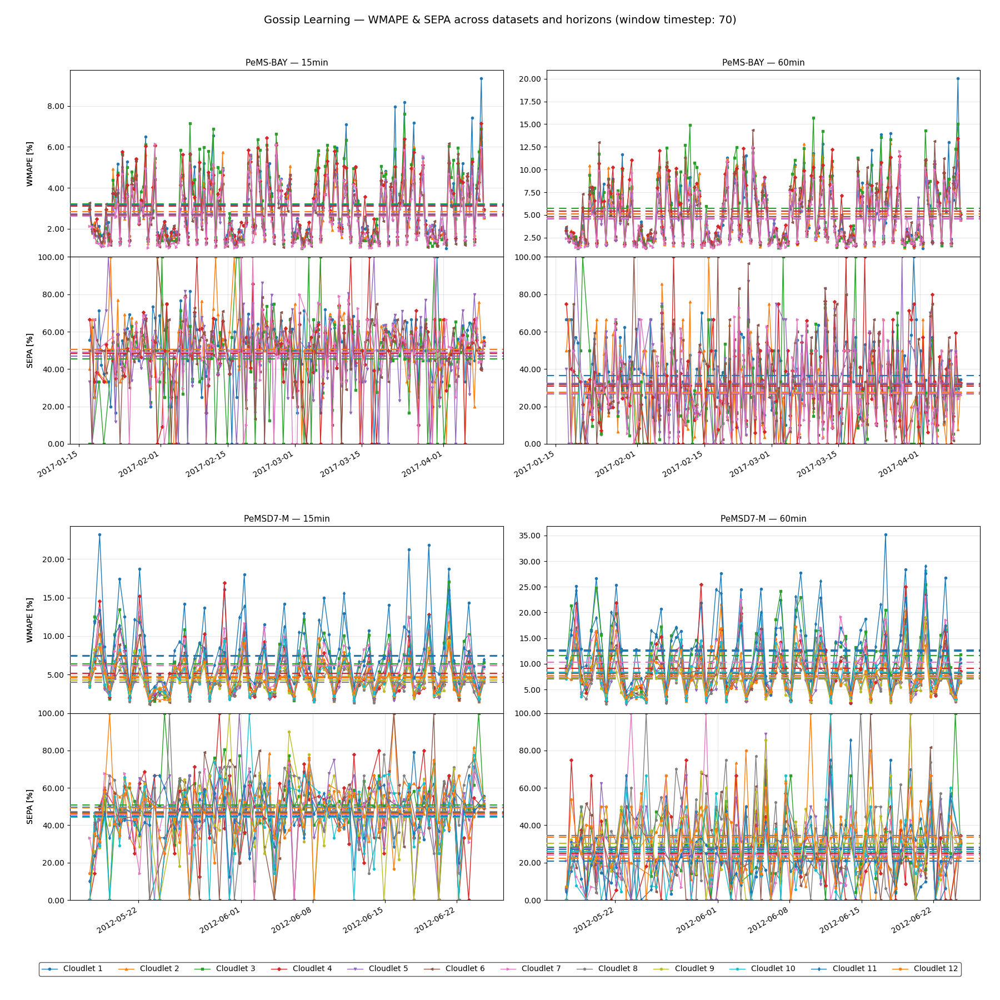

In [12]:
plot_sf_fl_wmape_scsr_by_dataset(
    folders={
        "Gossip Learning - PeMS-BAY - 15min": "2025-09-18_17-50-44_pems-bay_pred-15min_dps-70_gossip-learning-distance_online-training_with_algorithm",
        "Gossip Learning - PeMS-BAY - 60min": "2025-09-18_22-37-44_pems-bay_pred-60min_dps-70_gossip-learning-distance_online-training_with_algorithm",
        "Gossip Learning - PeMSD7-M - 15min": "2025-09-19_03-04-28_pemsd7-m_pred-15min_dps-70_gossip-learning-distance_online-training_with_algorithm",
        "Gossip Learning - PeMSD7-M - 60min": "2025-09-19_04-18-57_pemsd7-m_pred-60min_dps-70_gossip-learning-distance_online-training_with_algorithm",
    },
    training_setup="Gossip Learning",
    cloudlets_human=[1,2,3,4,5,6,7,8,9,10,11,12],
    timewindow=70,
)